## Interactive Notebook

Interactive notebook for displaying routes.

In [1]:
import main as utils

Display all holds:

ValueError: Could not save to JPEG for display

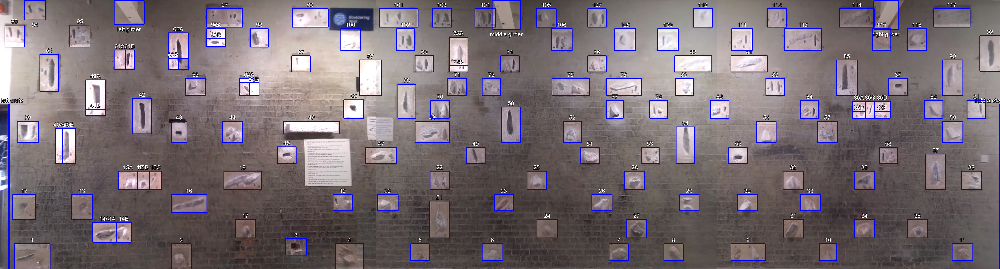

In [3]:
utils.highlight_all()

Display named route:

ValueError: Could not save to JPEG for display

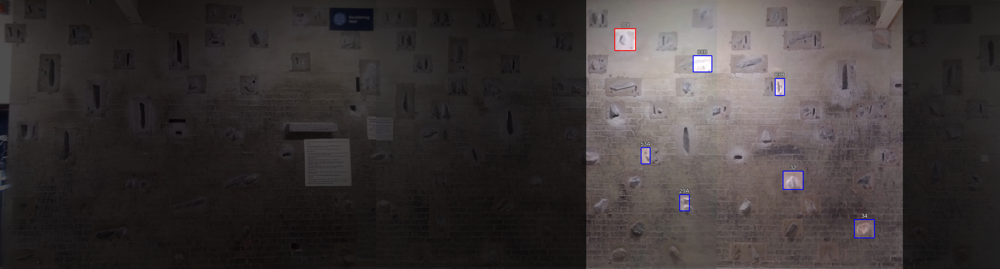

In [4]:
route = "Ecstasy"

utils.highlight_route(route, regenerate=False, save=False)

Display given holds:

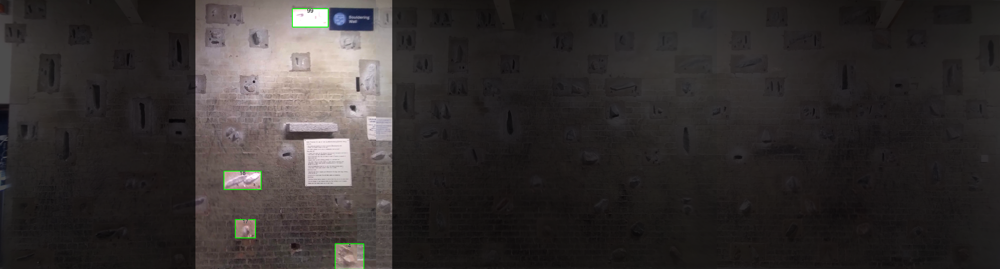

In [5]:
holds = [4, 17, 18, 99]

utils.highlight_holds(holds)

In [5]:
utils.HOLDS[101]

(2660, 60, 2930, 190)

In [6]:
utils.HOLDS

{'left arete': (60, 730, 65, 1895),
 'right arete': (7006, 730, 7200, 1895),
 'left girder': (800, 5, 1010, 170),
 'middle girder': (3450, 5, 3650, 205),
 'right girder': (6125, 5, 6300, 205),
 1: (100, 1710, 350, 1890),
 2: (1200, 1710, 1340, 1890),
 3: (2000, 1675, 2150, 1790),
 4: (2350, 1710, 2550, 1890),
 5: (2880, 1710, 3010, 1830),
 6: (3380, 1710, 3525, 1830),
 7: (4270, 1710, 4405, 1830),
 8: (4655, 1710, 4790, 1830),
 9: (5125, 1710, 5365, 1830),
 10: (5745, 1710, 5865, 1830),
 11: (6675, 1710, 6820, 1830),
 12: (90, 1365, 250, 1540),
 13: (500, 1365, 650, 1540),
 14: (650, 1560, 920, 1700),
 '14A': (650, 1560, 815, 1700),
 '14B': (815, 1560, 920, 1700),
 15: (830, 1200, 1130, 1330),
 '15A': (830, 1200, 965, 1330),
 '15B': (965, 1200, 1050, 1330),
 '15C': (1050, 1200, 1130, 1330),
 16: (1200, 1365, 1450, 1490),
 17: (1650, 1540, 1790, 1670),
 18: (1570, 1200, 1830, 1330),
 19: (2335, 1365, 2470, 1480),
 20: (2645, 1365, 2790, 1480),
 21: (3010, 1410, 3150, 1670),
 22: (3015, 

In [54]:
import pandas as pd

df_holds = pd.DataFrame.from_dict(utils.HOLDS, orient="index", columns=["pixel_x1", "pixel_y1", "pixel_x2","pixel_y2"])
df_holds = df_holds.reset_index()
df_holds = df_holds.append({"index":"girder", "pixel_x1" : 0, "pixel_y1" : 0, "pixel_x2" : 0, "pixel_y2" : 0  }, ignore_index = True)

df_holds.to_csv("df_holds.csv")

df_holds

,index,pixel_x1,pixel_y1,pixel_x2,pixel_y2
0,left arete,60,730,65,1895
1,right arete,7006,730,7200,1895
2,left girder,800,5,1010,170
3,middle girder,3450,5,3650,205
4,right girder,6125,5,6300,205
...,...,...,...,...,...
142,114,5885,60,6130,190
143,115,6115,200,6245,355
144,116,6360,200,6495,355
145,117,6545,60,6800,190


In [67]:
from src.routes import web_routes, web_routes_new

routes_total = web_routes | web_routes_new

print(routes_total["Obscenity"])

(5, 20, '70B', '73B', 'girder')


In [1]:
from src.routes import web_routes as guide_routes

print(len(guide_routes))

536


In [2]:
routes_dict = guide_routes
new_routes_dict = {}

for r in routes_dict:
    holds = []
    start_hold = []
    start_hold_nochar = []
    holds_str = ""
    stand_start = False
    for h in routes_dict[r]:
        if type(h) == tuple:
            start_hold = [str(hold) for hold in h]
            
            for hold in h:
                hold_nochar = str(hold).replace("A", "")
                hold_nochar = str(hold_nochar).replace("B", "")
                hold_nochar = str(hold_nochar).replace("C", "")
                hold_nochar = str(hold_nochar).replace("D", "")
                hold_nochar = str(hold_nochar).replace("E", "")
                start_hold_nochar.append(hold_nochar)
            holds.extend(start_hold_nochar)
            stand_start = True
            holds_str = holds_str + "(" + " ".join(start_hold) + ")"
            continue
        holds_str += " " + str(h)
        hold_nochar = str(h).replace("A", "")
        hold_nochar = str(hold_nochar).replace("B", "")
        hold_nochar = str(hold_nochar).replace("C", "")
        hold_nochar = str(hold_nochar).replace("D", "")
        hold_nochar = str(hold_nochar).replace("E", "")
        holds.append(str(hold_nochar))
        
    new_routes_dict[str(r)] = holds, start_hold_nochar, holds_str, stand_start

new_routes_dict



{'Jug-o-Rama': (['34', '58', '85', '35', '115', '114'],
  ['34', '58'],
  '(34 58A) 85 35 115 114',
  True),
 'The Ladder': (['2', '17', '16', '18', '43', '44', '63', '64', '98'],
  [],
  ' 2 17 16 18 43 44 63 64 98',
  False),
 'Baby Nemo': (['4', '66', '19', '20', '47', '69', '100'],
  ['4', '66'],
  '(4 66) 19 20 47 69 100A',
  True),
 "'Boing!' Said Zebedee": (['34', '85', '32', '112'],
  ['34'],
  '(34) 85 32 112B',
  True),
 'Ali G': (['30', '55', '81', '110'], ['30', '55'], '(30 55) 81 110', True),
 'Jack-In-The-Box': (['32', '35', '10', '85', '113', '115'],
  ['32', '35', '10'],
  '(32 35 10) 85A 113B 115',
  True),
 'Hatless': (['9', '10', '30', '32', '33', '56', '57', '85', '113'],
  [],
  ' 9 10 30 32 33 56 57A 85A 113B',
  False),
 'Crossroads': (['2', '16', '17', '18', '43', '44', '61'],
  [],
  ' 2 16 17 18 43 44 61',
  False),
 'Mean Feet': (['15', '1', '14', '42', '16', '43', '96'],
  ['15', '1', '14'],
  '(15A 1 14) 42 16 43 96B',
  True),
 '4b or not...': (['7', '26',

In [4]:
import pandas as pd
df_routes = pd.DataFrame.from_dict(new_routes_dict, orient = "index", columns=["holds", "start_holds", "holds_str", "stand_start"])
df_routes = df_routes.reset_index()

df_routes.to_csv("df_routes.csv")
df_routes

,index,holds,start_holds,holds_str,stand_start
0,Jug-o-Rama,"[34, 58, 85, 35, 115, 114]","[34, 58]",(34 58A) 85 35 115 114,True
1,The Ladder,"[2, 17, 16, 18, 43, 44, 63, 64, 98]",[],2 17 16 18 43 44 63 64 98,False
2,Baby Nemo,"[4, 66, 19, 20, 47, 69, 100]","[4, 66]",(4 66) 19 20 47 69 100A,True
3,'Boing!' Said Zebedee,"[34, 85, 32, 112]",[34],(34) 85 32 112B,True
4,Ali G,"[30, 55, 81, 110]","[30, 55]",(30 55) 81 110,True
...,...,...,...,...,...
531,"Taller Than You, Broadbent","[32, 34, 87, 38, 92]",[],32 34 87 38B 92,False
532,Ecstasy,"[34, 32, 83, 29, 88, 53, 108]",[],34 32 83B 29A 88B 53A 108,False
533,The Ultimate Everything,"[6, 23, 50, 78, 29, 88, 32, 84, 113]",[],6 23A 50 78A 29 88B 32 84A 113B,False
534,The Blair Bitch Project,"[6, 7, 25, 49, 73, 105]",[],6 7 25 49 73A 105,False


In [45]:
for _, row in df_routes.iterrows():
    for h in row['holds']:
        print(h)

34
58A
85
35
115
114
2
17
16
18
43
44
63
64
98
9
10
30
32
33
56
57A
85A
113B
4
19
20
47
66
69
100A
34
85
32
112B
30
55
81
110
15A
1
14
42
16
43
96B
8
53C
82A
80
30
32
81
113C
7
26
28
51
77B
75B
108
107A
23A
50
69A
47B
72B
104A
4
19
20
47
66
48A
69
101A
9
10
32
34
58A
85A
113B
2
17
16
3
18
45
63
98
9
10
30
32
55
81
113B
2
17
16
18
43
64
96B
4
19
20
47
66
69
101
3
17
18
46
64
98
99B
2
18
3
46
44
63
98
11
36
38B
38C
89
91
116A
117
12
41A
arete
40B
94B
10
32
57A
84B
85A
113A
4
19
20
46
66
100A
99B
4
19
3
45
17
18
64
98
9B
10
32
85A
115
8
28
29A
54
79A
80
108
8
28
53C
80
109A
46
47A
67A
99
98
64A
18
17
66
4B
48A
5
73B
77B
7
80
29B
30
81
32
85
4B
19B
46
44B
16
63
42
40
arete
7
26
28
51
77B
80
108
107A
4
17
19B
18
46
64B
98
17
18
64A
97B
26
52
77B
51
76B
105
2
16
43
42
44
96A
21
22A
47B
70B
102B
103B
4B
19
66
69
48B
101A
9
10
30
32
56
35
34
85
115
2
15B
44B
17
64B
45
98
1
39B
42
14B
17
44B
64B
45
98
11
34
36
37
59
86B
85A
115
2
16
43
63
96
7
8
28
29
54
78A
109A
106B
7
28
77B
51
78B
108
74B
1
